In [37]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import time
import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn import tree
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn.svm import SVC
from datetime import datetime, timedelta
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split, KFold, GridSearchCV
from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

In [38]:
# Đọc dữ liệu từ file csv
df = pd.read_csv("Hotel_DataMining.csv")
df.head(10)

,IsCanceled,LeadTime,Adults,Meal,Country,MarketSegment,DistributionChannel,IsRepeatedGuest,PreviousCancellations,PreviousBookingsNotCanceled,...,CustomerType,ADR,RequiredCarParkingSpaces,TotalOfSpecialRequests,hotel,StatuMinusArrivalDate,TotalNights,RoomMatch,TotalPeople,HaveChild
0,1,4,1,0,60,6,3,0,0,0,...,2,4,0,0,0,2,2,1,1,0
1,1,3,2,2,136,3,1,0,0,0,...,2,4,0,2,0,1,4,1,2,0
2,1,3,1,0,136,6,3,0,0,0,...,2,4,0,1,0,3,4,1,1,0
3,1,3,1,0,44,6,3,0,0,0,...,2,3,0,0,1,3,3,1,1,0
4,1,3,1,3,44,6,3,0,0,0,...,2,3,0,1,1,2,2,1,1,0
5,1,4,1,0,124,6,3,0,0,0,...,2,3,0,0,1,1,2,1,1,0
6,1,2,1,0,175,6,3,0,0,0,...,2,2,0,0,1,1,4,0,1,0
7,1,4,1,0,136,6,3,0,1,0,...,0,3,0,1,1,1,3,1,1,0
8,1,3,1,0,136,3,1,0,0,0,...,2,3,0,0,1,2,1,1,1,0
9,1,3,1,3,32,6,3,0,0,0,...,2,3,0,0,1,2,2,1,1,0


In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48008 entries, 0 to 48007
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype
---  ------                       --------------  -----
 0   IsCanceled                   48008 non-null  int64
 1   LeadTime                     48008 non-null  int64
 2   Adults                       48008 non-null  int64
 3   Meal                         48008 non-null  int64
 4   Country                      48008 non-null  int64
 5   MarketSegment                48008 non-null  int64
 6   DistributionChannel          48008 non-null  int64
 7   IsRepeatedGuest              48008 non-null  int64
 8   PreviousCancellations        48008 non-null  int64
 9   PreviousBookingsNotCanceled  48008 non-null  int64
 10  BookingChanges               48008 non-null  int64
 11  DepositType                  48008 non-null  int64
 12  CustomerType                 48008 non-null  int64
 13  ADR                          48008 non-null  i

# CHUẨN BỊ TRAIN, TEST

In [54]:
corr = 0.7  # Ngưỡng tương quan để xác định xem hai biến có tương quan cao hay không.

def correlation(dataset, threshold):
    col_corr = set()  # Tạo một tập hợp để lưu trữ tên của các cột có tương quan cao.
    corr_matrix = dataset.corr()  # Tính ma trận tương quan giữa tất cả các cặp biến.
    
    # Duyệt qua tất cả các cặp biến trong ma trận tương quan.
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:
                colname = corr_matrix.columns[i] 
                col_corr.add(colname) 
    return col_corr  # Trả về tập hợp các tên cột có tương quan cao.

In [55]:
# Tạo một bản sao của DataFrame gốc
df1 = df.copy()
corr_features = correlation(df1, corr)

# In ra thông tin về các thuộc tính có tương quan
print("-------------With corr equal: {0}-------------".format(corr))
print("Length of corr_feature equal: {0}".format(len(set(corr_features)))) 

# In ra danh sách các thuộc tính có tương quan bị loại bỏ
print("Correlated features to be removed:")
for feature in corr_features:
    print(feature)

# Loại bỏ các thuộc tính có tương quan cao từ DataFrame
df1 = df1.drop(corr_features, axis=1)

-------------With corr equal: 0.7-------------
Length of corr_feature equal: 2
Correlated features to be removed:
HaveChild
DistributionChannel


In [56]:
# Xóa cột 'IsCanceled' để lấy các thuộc tính khác
feature = df1.drop('IsCanceled',axis=1)
label = df1['IsCanceled']
# Chuyển đổi dữ liệu thành mảng NumPy
feature_np = np.array(feature)
label_np = np.array(label)

# CÀI ĐẶT CÁC HÀM CẦN THIẾT

In [57]:
# Thời gian và điểm số cho thuật toán Decision Tree ID3
TimeID3 = []
training_score_id3 = []
test_score_id3 = []
# Thời gian và điểm số cho thuật toán Decision Tree CART
TimeCart = []
training_score_cart = []
test_score_cart = []
# Thời gian và điểm số cho thuật toán Naïve Bayes
TimeNB = []
training_score_nb = []
test_score_nb = []
# Thời gian và điểm số cho thuật toán Random Forest
TimeRF = []
training_score_rf = []
test_score_rf = []
# Thời gian và điểm số cho thuật toán K - Nearest Neighbors
TimeKNN = []
training_score_knn = []
test_score_knn = []
# Thời gian và điểm số cho thuật toán Neural Network
TimeNN = []
training_score_nn = []
test_score_nn = []

In [58]:
# Lưu cây quyết định dựa trên thuật toán ID3 vào file ảnh.
def save_tree_id3(id3, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(id3,filled=True,fontsize=10)
  plt.savefig('DecisionTreeID3_{0}_{1}.png'.format(corr, i))
# Lưu cây quyết định dựa trên thuật toán CART vào file ảnh.
def save_tree_cart(cart, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(cart,filled=True,fontsize=10)
  plt.savefig('DecisionTreeCart_{0}_{1}.png'.format(corr, i))
# Lưu một cây ngẫu nhiên từ mô hình Random Forest vào file ảnh.
def save_randomForest(rf, i, corr, x_train):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(rf.estimators_[0], filled=True)
  plt.savefig('RandomForest_{0}_{1}.png'.format(corr, i))

In [59]:
# Định nghĩa hàm để vẽ biểu đồ ROC cho các thuật toán khác nhau
def Roc_Img(id3, cart, nb, rf, knn, nn, x_test, y_test, corr, i):
    # Thiết lập kích thước của hình ảnh
    plt.figure(figsize=(24,12))

    # Đối với Decision Tree ID3
    id3_probs = id3.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    id3_probs = id3_probs[:, 1]  # Chọn xác suất của lớp dương
    id3_auc = roc_auc_score(y_test, id3_probs)  # Tính AUC cho Decision Tree ID3
    print('Decision Tree ID3: ROC AUC=%.3f' % (id3_auc))  # In AUC
    id3_fpr, id3_tpr, _ = roc_curve(y_test, id3_probs)  # Tính FPR, TPR
    plt.plot(id3_fpr, id3_tpr, linestyle='--', label='Decision Tree ID3')  # Vẽ đường ROC

    # Đối với Decision Tree CART
    cart_probs = cart.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    cart_probs = cart_probs[:, 1]  # Chọn xác suất của lớp dương
    cart_auc = roc_auc_score(y_test, cart_probs)  # Tính AUC cho Decision Tree CART
    print('Decision Tree Cart: ROC AUC=%.3f' % (cart_auc))  # In AUC
    cart_fpr, cart_tpr, _ = roc_curve(y_test, cart_probs)  # Tính FPR, TPR
    plt.plot(cart_fpr, cart_tpr, linestyle='--', label='Decision Tree Cart')  # Vẽ đường ROC

    # Đối với Naive Bayes
    nb_probs = nb.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    nb_probs = nb_probs[:, 1]  # Chọn xác suất của lớp dương
    nb_auc = roc_auc_score(y_test, nb_probs)  # Tính AUC cho Naive Bayes
    print('Naive Bayes: ROC AUC=%.3f' % (nb_auc))  # In AUC
    nb_fpr, nb_tpr, _ = roc_curve(y_test, nb_probs)  # Tính FPR, TPR
    plt.plot(nb_fpr, nb_tpr, linestyle='--', label='Naive Bayes')  # Vẽ đường ROC

    # Đối với Random Forest
    rf_probs = rf.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    rf_probs = rf_probs[:, 1]  # Chọn xác suất của lớp dương
    rf_auc = roc_auc_score(y_test, rf_probs)  # Tính AUC cho Random Forest
    print('Random Forest: ROC AUC=%.3f' % (rf_auc))  # In AUC
    rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_probs)  # Tính FPR, TPR
    plt.plot(rf_fpr, rf_tpr, linestyle='--', label='Random Forest')  # Vẽ đường ROC

    # Đối với K Nearest Neighbors
    knn_probs = knn.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    knn_probs = knn_probs[:, 1]  # Chọn xác suất của lớp dương
    knn_auc = roc_auc_score(y_test, knn_probs)  # Tính AUC cho K Nearest Neighbors
    print('K Nearest Neighbors ROC AUC=%.3f' % (knn_auc))  # In AUC
    knn_fpr, knn_tpr, _ = roc_curve(y_test, knn_probs)  # Tính FPR, TPR
    plt.plot(knn_fpr, knn_tpr, linestyle='--', label='K Nearest Neighbors')  # Vẽ đường ROC

    # Đối với Neural Network
    nn_probs = nn.predict_proba(x_test)  # Dự đoán xác suất cho x_test
    nn_probs = nn_probs[:, 1]  # Chọn xác suất của lớp dương
    nn_auc = roc_auc_score(y_test, nn_probs)  # Tính AUC cho Neural Network
    print('Neural Network: ROC AUC=%.3f' % (nn_auc))  # In AUC
    nn_fpr, nn_tpr, _ = roc_curve(y_test, nn_probs)  # Tính FPR, TPR
    plt.plot(nn_fpr, nn_tpr, linestyle='--', label='Neural Network')  # Vẽ đường ROC

    # Đặt nhãn cho trục x và trục y
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    
    # Hiển thị legend
    plt.legend()

    # Lưu hình ảnh với tên file chứa chuỗi 'corr'
    plt.savefig('ROC_{0}_{1}.png'.format(corr, i))

In [62]:
def get_score(x_train, x_test, y_train, y_test, i, corr): 
  # Decision Tree ID3
  print("-----Decision Tree ID3-----")
  start= time.time()
  # Tạo một cây quyết định dựa trên giải thuật ID3
  id3 = tree.DecisionTreeClassifier(criterion="entropy",random_state=0)
  # Huấn luyện mô hình
  id3.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeID3
  TimeID3.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_id3.append(id3.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  id3_pred = id3.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_id3
  id3_score = metrics.accuracy_score(y_test, id3_pred)
  test_score_id3.append(id3_score)
  # In kết quả accuracy và báo cáo phân loại
  print("Decision Tree ID3")
  print("Accruracy:",id3_score)
  print("Report:",metrics.classification_report(y_test,id3_pred))
  # Tạo ma trận nhầm lẫn
  id3_cm = metrics.confusion_matrix(y_test,id3_pred)
  # Lưu cây quyết định đã huấn luyện
  save_tree_id3(id3, i, corr)
  
  # Decision Tree CART
  print("-----Decision Tree Cart-----")
  start= time.time()
  # Tạo một cây quyết định dựa trên giải thuật CART
  cart = tree.DecisionTreeClassifier(criterion="gini",random_state=0)
  # Huấn luyện mô hình
  cart.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeCart
  TimeCart.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_cart.append(cart.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  cart_pred = cart.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_cart
  cart_score = metrics.accuracy_score(y_test, cart_pred)
  test_score_cart.append(cart_score)
  # In kết quả accuracy và báo cáo phân loại
  print("Decision Tree Cart")
  print("Accruracy:",cart_score)
  print("Report:",metrics.classification_report(y_test,cart_pred))
  # Tạo ma trận nhầm lẫn
  cart_cm = metrics.confusion_matrix(y_test,cart_pred)
  # Lưu cây quyết định đã huấn luyện
  save_tree_cart(cart, i, corr)
  
  # Naive Bayes
  print("-----Naive Bayes-----")
  start= time.time()
  # Tạo một mô hình Naive Bayes
  nb = GaussianNB()
  # Huấn luyện mô hình
  nb.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeNB
  TimeNB.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_nb.append(nb.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  nb_pred = nb.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_nb
  nb_score = metrics.accuracy_score(y_test, nb_pred)
  test_score_nb.append(nb_score)
  # In kết quả accuracy và báo cáo phân loại
  print("Naive Bayes")
  print("Accruracy:",nb_score)
  print("Report:",metrics.classification_report(y_test,nb_pred))
  #Tạo ma trận nhầm lẫn
  nb_cm = metrics.confusion_matrix(y_test,nb_pred)
  
 # Random Forest
  print("-----Random Forest-----")
  start= time.time()
  # Tạo một mô hình Random Forest
  rf = RandomForestClassifier()
  # Huấn luyện mô hình
  rf.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeRF
  TimeRF.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_rf.append(rf.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  rf_pred = rf.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_rf
  rf_score = metrics.accuracy_score(y_test, rf_pred)
  test_score_rf.append(rf_score)
  # In kết quả accuracy và báo cáo phân loại
  print("Random Forest")
  print("Accruracy:",rf_score)
  print("Report:",metrics.classification_report(y_test,rf_pred))
  # Tạo ma trận nhầm lẫn
  rf_cm = metrics.confusion_matrix(y_test,rf_pred)
  # Lưu mô hình Random Forest
  save_randomForest(rf, i, corr, x_train)
  
  # K-Nearest Neighbor
  print("-----K-Nearest Neighbor-----")
  start= time.time()
  # Tạo một mô hình K-Nearest Neighbor
  knn = KNeighborsClassifier()
  # Huấn luyện mô hình
  knn.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeKNN
  TimeKNN.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_knn.append(knn.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  knn_pred = knn.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_knn
  knn_score = metrics.accuracy_score(y_test, knn_pred)
  test_score_knn.append(knn_score)
  # In kết quả accuracy và báo cáo phân loại
  print("K-Nearest Neighbor")
  print("Accruracy:",knn_score)
  print("Report:",metrics.classification_report(y_test,knn_pred))
  # Tạo ma trận nhầm lẫn
  knn_cm = metrics.confusion_matrix(y_test,knn_pred)
  
 # Neural Network
  print("-----Neural Network-----")
  start= time.time()
  # Tạo một mô hình Neural Network
  nn = MLPClassifier(random_state=0, activation="logistic", solver="sgd")
  # Huấn luyện mô hình
  nn.fit(x_train,y_train)
  end = time.time()
  # Đo thời gian huấn luyện và lưu vào danh sách TimeNN
  TimeNN.append(end - start)
  # Đánh giá hiệu suất trên tập huấn luyện và lưu kết quả
  training_score_nn.append(nn.score(x_train, y_train))
  # Dự đoán nhãn trên tập kiểm tra
  nn_pred = nn.predict(x_test)
  # Tính toán accuracy và lưu vào danh sách test_score_nn
  nn_score = metrics.accuracy_score(y_test, nn_pred)
  test_score_nn.append(nn_score)
  # In kết quả accuracy và báo cáo phân loại
  print("Neural Network")
  print("Accruracy:",nn_score)
  print("Report:",metrics.classification_report(y_test,nn_pred))
  # Tạo ma trận nhầm lẫn
  nn_cm = metrics.confusion_matrix(y_test,nn_pred)
  
# Trực quan hóa ma trận nhầm lẫn
  plt.figure(figsize=(24,12))

  plt.suptitle("Ma trận nhầm lẫn", fontsize=24)
  plt.subplots_adjust(wspace=0.4, hspace=0.4)

  plt.subplot(3, 2, 1)
  plt.title("Ma trận nhầm lẫn của Cây quyết định ID3")
  sns.heatmap(id3_cm, annot=True, cmap="Blues", fmt="d", annot_kws={"size": 24})

  plt.subplot(3, 2, 2)
  plt.title("Ma trận nhầm lẫn của Cây quyết định Cart")
  sns.heatmap(cart_cm, annot=True, cmap="Reds", fmt="d", annot_kws={"size": 24})

  plt.subplot(3, 2, 3)
  plt.title("Ma trận nhầm lẫn của Naive Bayes")
  sns.heatmap(nb_cm, annot=True, cmap="Greens", fmt="d", annot_kws={"size": 24})

  plt.subplot(3, 2, 4)
  plt.title("Ma trận nhầm lẫn của Random Forest")
  sns.heatmap(rf_cm, annot=True, cmap="Purples", fmt="d", annot_kws={"size": 24})

  plt.subplot(3, 2, 5)
  plt.title("Ma trận nhầm lẫn của K-Nearest Neighbor")
  sns.heatmap(knn_cm, annot=True, cmap="Oranges", fmt="d", annot_kws={"size": 24})

  plt.subplot(3, 2, 6)
  plt.title("Ma trận nhầm lẫn của Neural Network")
  sns.heatmap(nn_cm, annot=True, cmap="plasma", fmt="d", annot_kws={"size": 24})

  # Lưu hình ảnh ma trận nhầm lẫn
  plt.savefig('ConfusionMatrix_{0}_{1}.png'.format(corr, i))
  
  # Tạo biểu đồ ROC
  Roc_Img(id3, cart, nb, rf, knn, nn, x_test, y_test, corr, i)

# CHẠY CÁC THUẬT TOÁN

---------Lần thứ: 1---------
-----Decision Tree ID3-----
Decision Tree ID3
Accruracy: 0.8347566479205721
Report:               precision    recall  f1-score   support

           0       0.82      0.85      0.84      7235
           1       0.85      0.82      0.83      7168

    accuracy                           0.83     14403
   macro avg       0.84      0.83      0.83     14403
weighted avg       0.84      0.83      0.83     14403

-----Decision Tree Cart-----
Decision Tree Cart
Accruracy: 0.8355203776990905
Report:               precision    recall  f1-score   support

           0       0.82      0.85      0.84      7235
           1       0.85      0.82      0.83      7168

    accuracy                           0.84     14403
   macro avg       0.84      0.84      0.84     14403
weighted avg       0.84      0.84      0.84     14403

-----Naive Bayes-----
Naive Bayes
Accruracy: 0.6443796431299035
Report:               precision    recall  f1-score   support

           0       0

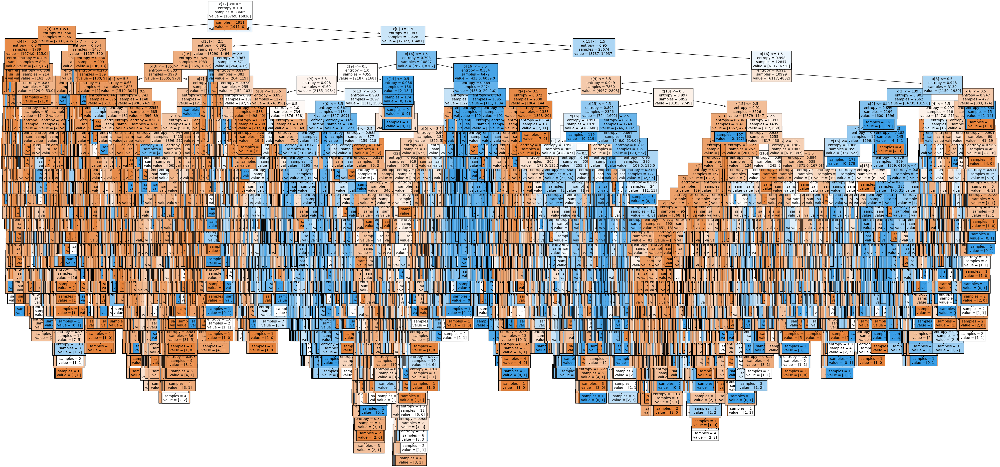

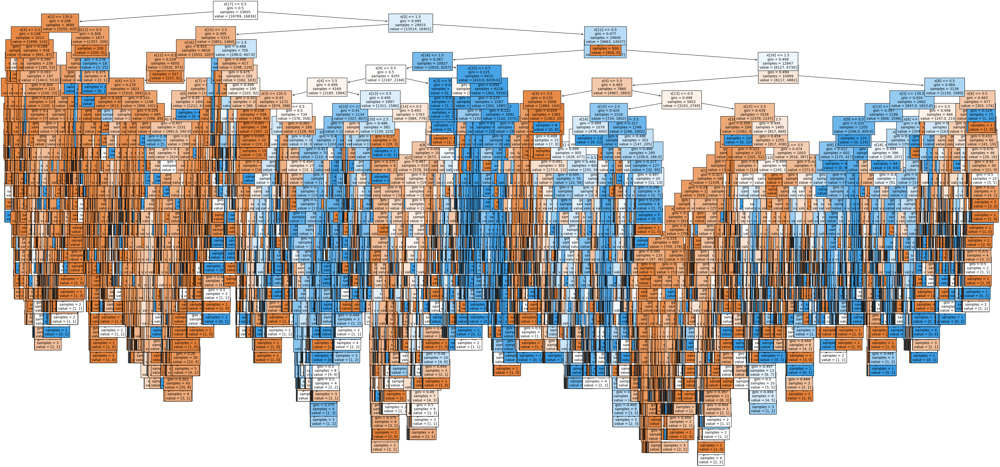

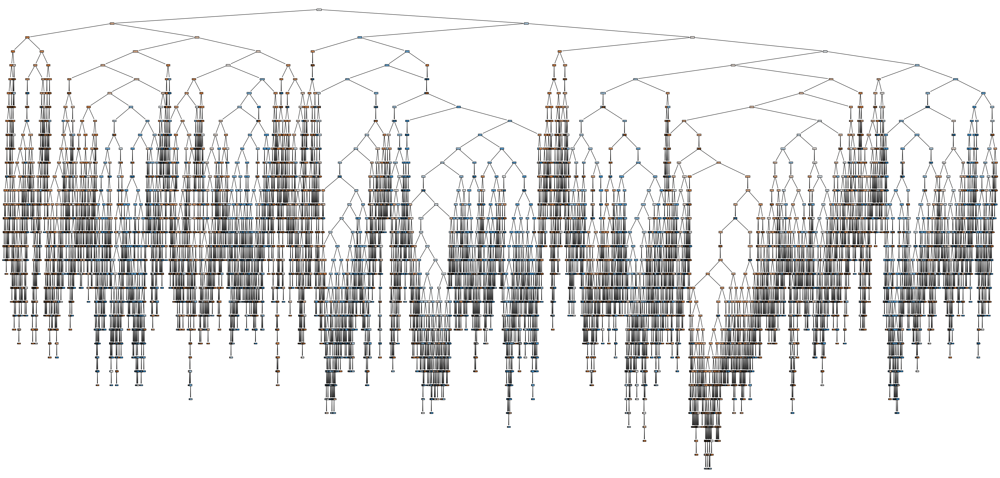

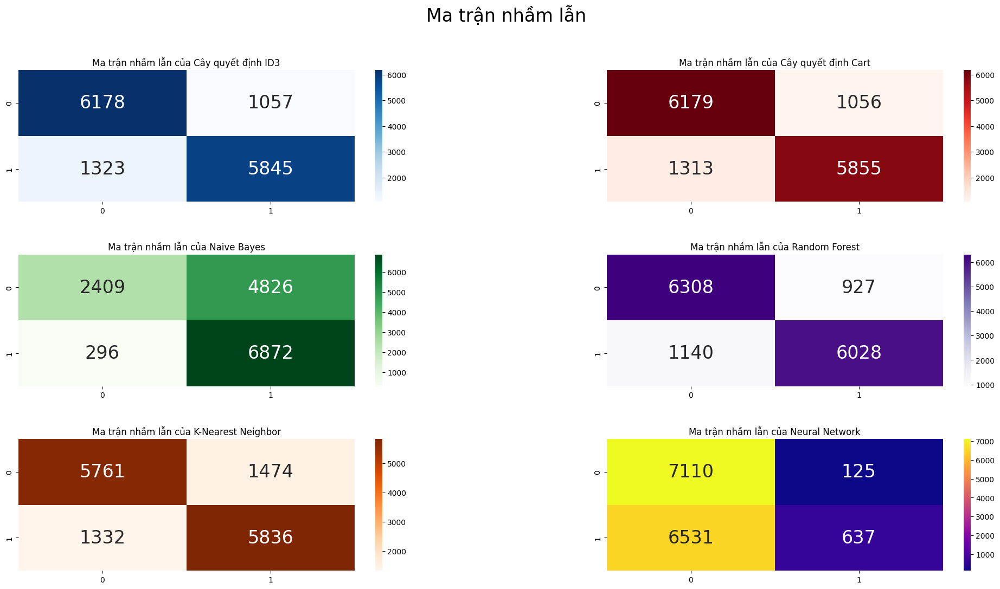

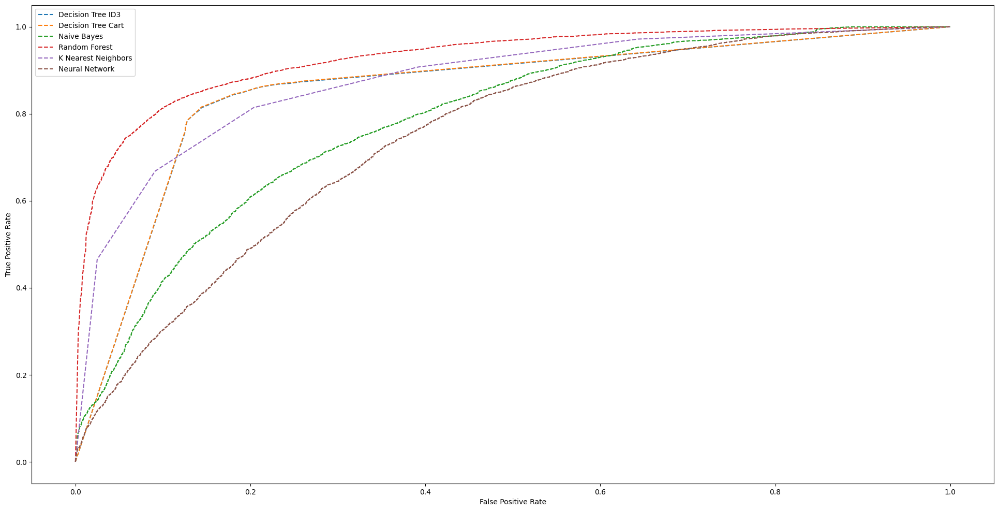

...

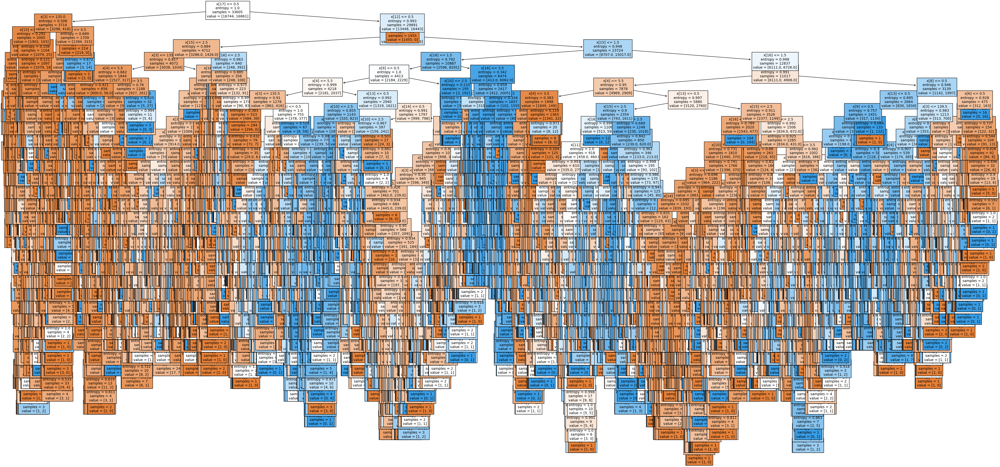

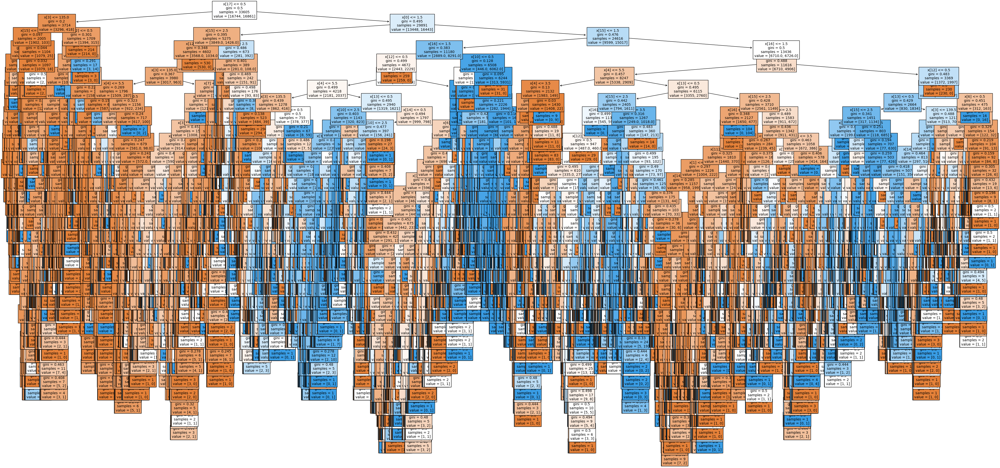

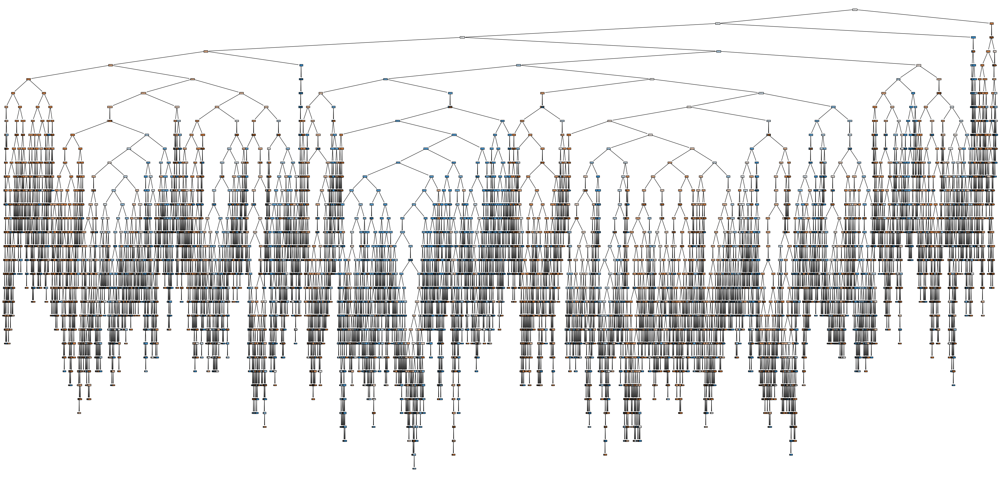

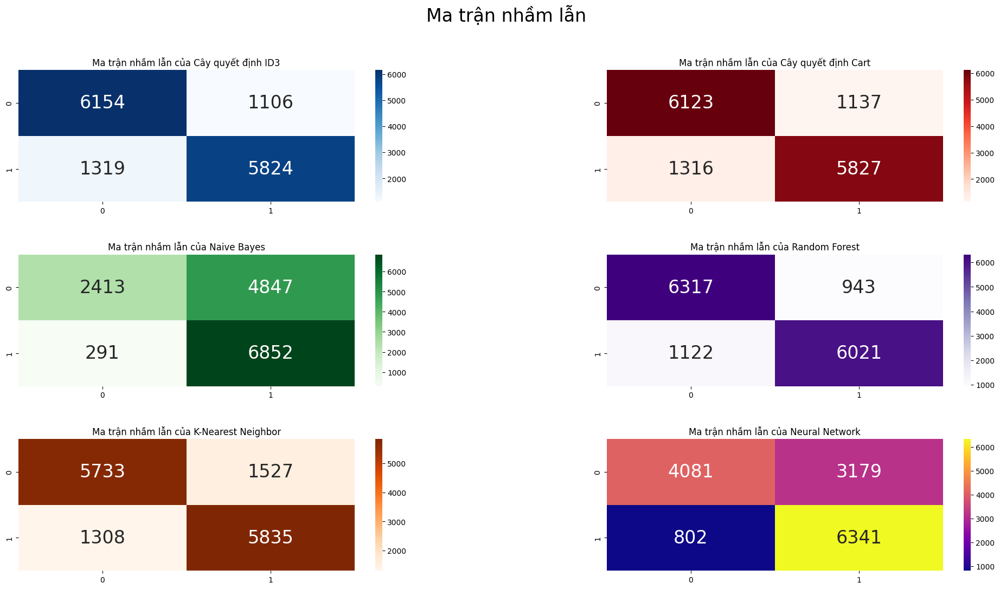

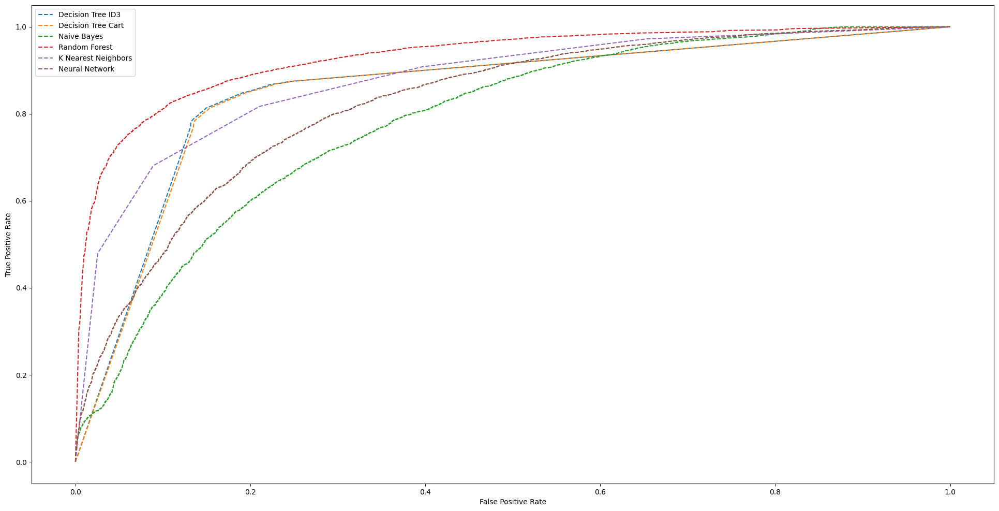

In [63]:
# Chia tập dữ liệu thành tập huấn luyện và kiểm tra và chạy các thuật toán
folds = ShuffleSplit(n_splits=3, random_state=10, test_size=0.3)
i = 1
for train_index, test_index in folds.split(label_np):
    print("---------Lần thứ: {}---------".format(i))
    x_train, x_test = feature_np[train_index], feature_np[test_index]
    y_train, y_test = label_np[train_index], label_np[test_index]    
    get_score(x_train, x_test, y_train, y_test, i, corr)
    i = i + 1

# ĐÁNH GIÁ CÁC THUẬT TOÁN


In [64]:
def mean(lst):
    return sum(lst) / len(lst)

#### ĐÁNH GIÁ THỜI GIAN CHẠY CỦA TỪNG THUẬT TOÁN

In [75]:
df_time = pd.DataFrame(data=[('Decision Tree ID3',mean(TimeID3)), ('Decision Tree Cart',mean(TimeCart)), 
                             ('Naive Bayes',mean(TimeNB)), ('Random Forest',mean(TimeRF)),
                             ('K-Nearest Neighbor',mean(TimeKNN)), ('Neural Network',mean(TimeNN))], columns=['Model', 'Time'])
df_time

,Model,Time
0,Decision Tree ID3,0.128959
1,Decision Tree Cart,0.123357
2,Naive Bayes,0.022168
3,Random Forest,3.403580
4,K-Nearest Neighbor,0.003069
5,Neural Network,67.365045


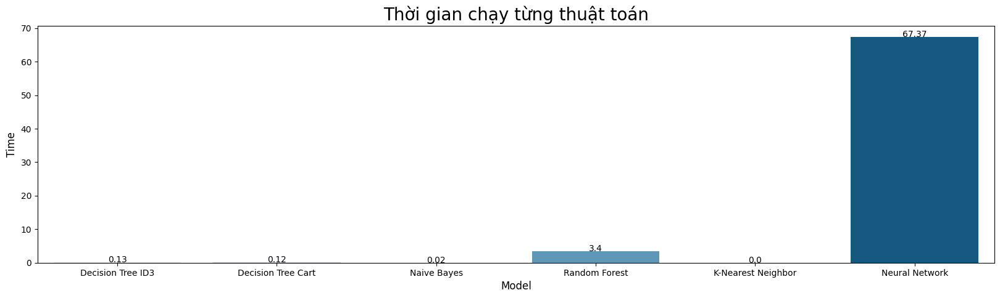

In [76]:
# Vẽ biểu đồ
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Time', data=df_time, palette='PuBu')
plt.title('Thời gian chạy từng thuật toán', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Time', fontsize = 12)
for index, row in df_time.iterrows():
    p.text(x=row.name, y=row.Time, s=round(row.Time,2), color='black', horizontalalignment='center');

#### ĐÁNH GIÁ ĐỘ CHÍNH XÁC CỦA TẬP TRAIN

In [77]:
df_train = pd.DataFrame(data=[('Decision Tree ID3',mean(training_score_id3)), ('Decision Tree Cart',mean(training_score_cart)), 
                             ('Naive Bayes',mean(training_score_nb)), ('Random Forest',mean(training_score_rf)), 
                             ('K-Nearest Neighbor',mean(training_score_knn)), ('Neural Network',mean(training_score_nn))], columns=['Model', 'Accuracy'])
df_train

,Model,Accuracy
0,Decision Tree ID3,0.954233
1,Decision Tree Cart,0.954233
2,Naive Bayes,0.644071
3,Random Forest,0.954233
4,K-Nearest Neighbor,0.867579
5,Neural Network,0.634459


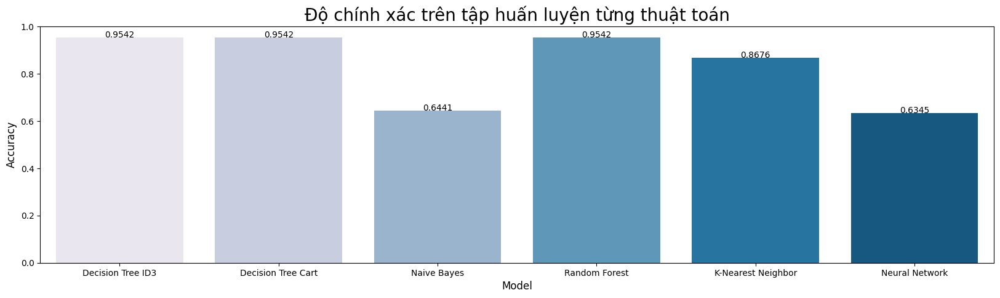

In [78]:
# Vẽ biểu đồ
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_train, palette='PuBu')
plt.title('Độ chính xác trên tập huấn luyện từng thuật toán', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_train.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

#### ĐÁNH GIÁ ĐỘ CHÍNH XÁC CỦA TẬP TEST

In [80]:
df_test = pd.DataFrame(data=[('Decision Tree ID3',mean(test_score_id3)), ('Decision Tree Cart',mean(test_score_cart)), 
                             ('Naive Bayes',mean(test_score_nb)), ('Random Forest',mean(test_score_rf)), 
                             ('K-Nearest Neighbor',mean(test_score_knn)), ('Neural Network',mean(test_score_nn))],columns=['Model', 'Accuracy'])
df_test

,Model,Accuracy
0,Decision Tree ID3,0.833275
1,Decision Tree Cart,0.831331
2,Naive Bayes,0.643431
3,Random Forest,0.855030
4,K-Nearest Neighbor,0.803860
5,Neural Network,0.636395


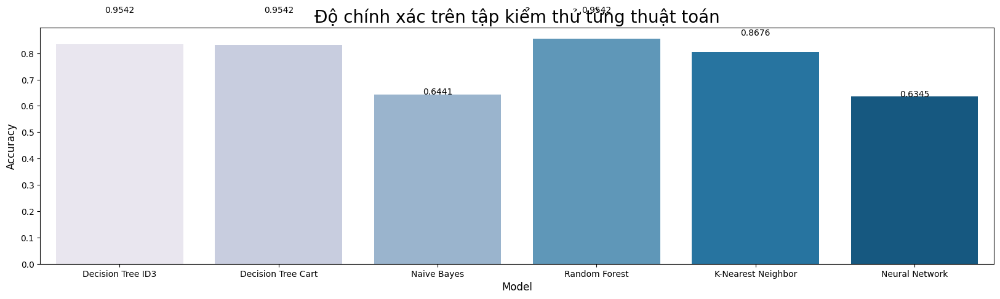

In [89]:
# Vẽ biểu đồ
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_test, palette='PuBu')
plt.title('Độ chính xác trên tập kiểm thử từng thuật toán', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_train.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');